In [1]:
apple = [10,7,55,15,7,5]
orange = [20,14,15,14,1,4]
banana = [30,21,8,1,1,9]
pear = [40,28,12,8,8,2]
import pandas as pd

# Create a DataFrame
data = pd.DataFrame({
    'Apple': apple,
    'Orange': orange,
    'Banana': banana,
    'Pear': pear
}, index = ['Bag1','Bag2','Bag3','Bag4','Bag5','Bag6' ])

# Print the DataFrame
print(data)

      Apple  Orange  Banana  Pear
Bag1     10      20      30    40
Bag2      7      14      21    28
Bag3     55      15       8    12
Bag4     15      14       1     8
Bag5      7       1       1     8
Bag6      5       4       9     2


In [2]:
data.describe()

,Apple,Orange,Banana,Pear
count,6.000000,6.000000,6.000000,6.000000
mean,16.500000,11.333333,11.666667,16.333333
std,19.180719,7.257180,11.587349,14.555640
min,5.000000,1.000000,1.000000,2.000000
25%,7.000000,6.500000,2.750000,8.000000
50%,8.500000,14.000000,8.500000,10.000000
75%,13.750000,14.750000,18.000000,24.000000
max,55.000000,20.000000,30.000000,40.000000


In [3]:
from statistics import mean, median, mode

apple_mean = mean(apple)
orange_mean = mean(orange)
banana_mean = mean(banana)
pear_mean = mean(pear)
means = [apple_mean,orange_mean, banana_mean, pear_mean]
means = pd.DataFrame({
    'Mean': [apple_mean, orange_mean, banana_mean, pear_mean]
}, index=['Apple', 'Orange', 'Banana', 'Pear'])


In [4]:
means

,Mean
Apple,16.500000
Orange,11.333333
Banana,11.666667
Pear,16.333333


In [5]:
path = "C:\\Users\\alok\\Downloads\\Books.csv"

books = pd.read_csv(path)

In [6]:
books

,Name,Author,User Rating,Reviews,Price,Year,Genre
0,"Act Like a Lady, Think Like a Man: What Men Re...",Steve Harvey,4.6,5013,17,2009,Non Fiction
1,Arguing with Idiots: How to Stop Small Minds a...,Glenn Beck,4.6,798,5,2009,Non Fiction
2,"Breaking Dawn (The Twilight Saga, Book 4)",Stephenie Meyer,4.6,9769,13,2009,Fiction
3,Crazy Love: Overwhelmed by a Relentless God,Francis Chan,4.7,1542,14,2009,Non Fiction
4,Dead And Gone: A Sookie Stackhouse Novel (Sook...,Charlaine Harris,4.6,1541,4,2009,Fiction
...,...,...,...,...,...,...,...
695,The Wonderful Things You Will Be,Emily Winfield Martin,4.9,20920,9,2022,Fiction
696,Ugly Love: A Novel,Colleen Hoover,4.7,33929,10,2022,Fiction
697,Verity,Colleen Hoover,4.6,71826,11,2022,Fiction
698,What to Expect When You're Expecting,Heidi Murkoff,4.8,27052,13,2022,Non Fiction


In [7]:
books.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700 entries, 0 to 699
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Name         700 non-null    object 
 1   Author       700 non-null    object 
 2   User Rating  700 non-null    float64
 3   Reviews      700 non-null    int64  
 4   Price        700 non-null    int64  
 5   Year         700 non-null    int64  
 6   Genre        700 non-null    object 
dtypes: float64(1), int64(3), object(3)
memory usage: 38.4+ KB


In [8]:
books.describe()

,User Rating,Reviews,Price,Year
count,700.000000,700.000000,700.000000,700.000000
mean,4.639857,19255.195714,12.700000,2015.500000
std,0.218586,23613.443875,9.915162,4.034011
min,3.300000,37.000000,0.000000,2009.000000
25%,4.500000,4987.250000,7.000000,2012.000000
50%,4.700000,10284.000000,11.000000,2015.500000
75%,4.800000,23358.000000,15.000000,2019.000000
max,4.900000,208917.000000,105.000000,2022.000000


In [9]:
books.columns

Index(['Name', 'Author', 'User Rating', 'Reviews', 'Price', 'Year', 'Genre'], dtype='object')

In [10]:

author_stats = books.groupby('Author').agg({'User Rating': 'mean', 'Price': 'mean'}).reset_index()
author_stats.columns = ['Author', 'Avg Rating', 'Avg Price']

In [11]:
# Merge the calculated statistics with the original DataFrame
books_data = pd.merge(books, author_stats, on='Author', how='left')

In [12]:
books_data

,Name,Author,User Rating,Reviews,Price,Year,Genre,Avg Rating,Avg Price
0,"Act Like a Lady, Think Like a Man: What Men Re...",Steve Harvey,4.6,5013,17,2009,Non Fiction,4.600000,17.000000
1,Arguing with Idiots: How to Stop Small Minds a...,Glenn Beck,4.6,798,5,2009,Non Fiction,4.600000,10.500000
2,"Breaking Dawn (The Twilight Saga, Book 4)",Stephenie Meyer,4.6,9769,13,2009,Fiction,4.675000,19.125000
3,Crazy Love: Overwhelmed by a Relentless God,Francis Chan,4.7,1542,14,2009,Non Fiction,4.700000,14.000000
4,Dead And Gone: A Sookie Stackhouse Novel (Sook...,Charlaine Harris,4.6,1541,4,2009,Fiction,4.450000,10.250000
...,...,...,...,...,...,...,...,...,...
695,The Wonderful Things You Will Be,Emily Winfield Martin,4.9,20920,9,2022,Fiction,4.900000,9.666667
696,Ugly Love: A Novel,Colleen Hoover,4.7,33929,10,2022,Fiction,4.683333,11.500000
697,Verity,Colleen Hoover,4.6,71826,11,2022,Fiction,4.683333,11.500000
698,What to Expect When You're Expecting,Heidi Murkoff,4.8,27052,13,2022,Non Fiction,4.600000,11.000000


In [13]:
author_book_counts = books['Author'].value_counts()
author_book_counts

Author
Jeff Kinney                           14
Gary Chapman                          14
Suzanne Collins                       12
Rick Riordan                          11
American Psychological Association    11
                                      ..
Randall Munroe                         1
Coloring Books for Adults              1
Chris Kyle                             1
Angie Grace                            1
Stephen Perrine                        1
Name: count, Length: 305, dtype: int64

In [14]:
hr_path = "C:\\Users\\alok\\Downloads\\HRDataset_v14.csv"

In [15]:
hr_data = pd.read_csv(hr_path)

In [16]:
hr_data

,Employee_Name,EmpID,MarriedID,MaritalStatusID,GenderID,EmpStatusID,DeptID,PerfScoreID,FromDiversityJobFairID,Salary,...,ManagerName,ManagerID,RecruitmentSource,PerformanceScore,EngagementSurvey,EmpSatisfaction,SpecialProjectsCount,LastPerformanceReview_Date,DaysLateLast30,Absences
0,"Adinolfi, Wilson K",10026,0,0,1,1,5,4,0,62506,...,Michael Albert,22.0,LinkedIn,Exceeds,4.60,5,0,1/17/2019,0,1
1,"Ait Sidi, Karthikeyan",10084,1,1,1,5,3,3,0,104437,...,Simon Roup,4.0,Indeed,Fully Meets,4.96,3,6,2/24/2016,0,17
2,"Akinkuolie, Sarah",10196,1,1,0,5,5,3,0,64955,...,Kissy Sullivan,20.0,LinkedIn,Fully Meets,3.02,3,0,5/15/2012,0,3
3,"Alagbe,Trina",10088,1,1,0,1,5,3,0,64991,...,Elijiah Gray,16.0,Indeed,Fully Meets,4.84,5,0,1/3/2019,0,15
4,"Anderson, Carol",10069,0,2,0,5,5,3,0,50825,...,Webster Butler,39.0,Google Search,Fully Meets,5.00,4,0,2/1/2016,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
306,"Woodson, Jason",10135,0,0,1,1,5,3,0,65893,...,Kissy Sullivan,20.0,LinkedIn,Fully Meets,4.07,4,0,2/28/2019,0,13
307,"Ybarra, Catherine",10301,0,0,0,5,5,1,0,48513,...,Brannon Miller,12.0,Google Search,PIP,3.20,2,0,9/2/2015,5,4
308,"Zamora, Jennifer",10010,0,0,0,1,3,4,0,220450,...,Janet King,2.0,Employee Referral,Exceeds,4.60,5,6,2/21/2019,0,16
309,"Zhou, Julia",10043,0,0,0,1,3,3,0,89292,...,Simon Roup,4.0,Employee Referral,Fully Meets,5.00,3,5,2/1/2019,0,11


In [17]:
hr_data.columns

Index(['Employee_Name', 'EmpID', 'MarriedID', 'MaritalStatusID', 'GenderID',
       'EmpStatusID', 'DeptID', 'PerfScoreID', 'FromDiversityJobFairID',
       'Salary', 'Termd', 'PositionID', 'Position', 'State', 'Zip', 'DOB',
       'Sex', 'MaritalDesc', 'CitizenDesc', 'HispanicLatino', 'RaceDesc',
       'DateofHire', 'DateofTermination', 'TermReason', 'EmploymentStatus',
       'Department', 'ManagerName', 'ManagerID', 'RecruitmentSource',
       'PerformanceScore', 'EngagementSurvey', 'EmpSatisfaction',
       'SpecialProjectsCount', 'LastPerformanceReview_Date', 'DaysLateLast30',
       'Absences'],
      dtype='object')

In [18]:
department_grouped = hr_data.groupby('Department')['Salary'].agg(['mean', 'median']).reset_index()
department_grouped.columns = ['Department', 'mean_salary', 'median_salary']

In [19]:
department_grouped

,Department,mean_salary,median_salary
0,Admin Offices,71791.888889,63003.0
1,Executive Office,250000.000000,250000.0
2,IT/IS,97064.640000,92328.5
3,Production,59953.545455,59472.0
4,Sales,69061.258065,65310.0
5,Software Engineering,94989.454545,95660.0


In [20]:
hr = pd.merge(hr_data, department_grouped, on='Department', how='left')

In [21]:
hr

,Employee_Name,EmpID,MarriedID,MaritalStatusID,GenderID,EmpStatusID,DeptID,PerfScoreID,FromDiversityJobFairID,Salary,...,RecruitmentSource,PerformanceScore,EngagementSurvey,EmpSatisfaction,SpecialProjectsCount,LastPerformanceReview_Date,DaysLateLast30,Absences,mean_salary,median_salary
0,"Adinolfi, Wilson K",10026,0,0,1,1,5,4,0,62506,...,LinkedIn,Exceeds,4.60,5,0,1/17/2019,0,1,59953.545455,59472.0
1,"Ait Sidi, Karthikeyan",10084,1,1,1,5,3,3,0,104437,...,Indeed,Fully Meets,4.96,3,6,2/24/2016,0,17,97064.640000,92328.5
2,"Akinkuolie, Sarah",10196,1,1,0,5,5,3,0,64955,...,LinkedIn,Fully Meets,3.02,3,0,5/15/2012,0,3,59953.545455,59472.0
3,"Alagbe,Trina",10088,1,1,0,1,5,3,0,64991,...,Indeed,Fully Meets,4.84,5,0,1/3/2019,0,15,59953.545455,59472.0
4,"Anderson, Carol",10069,0,2,0,5,5,3,0,50825,...,Google Search,Fully Meets,5.00,4,0,2/1/2016,0,2,59953.545455,59472.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
306,"Woodson, Jason",10135,0,0,1,1,5,3,0,65893,...,LinkedIn,Fully Meets,4.07,4,0,2/28/2019,0,13,59953.545455,59472.0
307,"Ybarra, Catherine",10301,0,0,0,5,5,1,0,48513,...,Google Search,PIP,3.20,2,0,9/2/2015,5,4,59953.545455,59472.0
308,"Zamora, Jennifer",10010,0,0,0,1,3,4,0,220450,...,Employee Referral,Exceeds,4.60,5,6,2/21/2019,0,16,97064.640000,92328.5
309,"Zhou, Julia",10043,0,0,0,1,3,3,0,89292,...,Employee Referral,Fully Meets,5.00,3,5,2/1/2019,0,11,97064.640000,92328.5


# Topics

In [22]:
from scipy.stats import iqr, zscore, skew, kurtosis

In [23]:
print('whole_data',iqr(hr['Salary'], axis = 0))
print('departmentwise',iqr(department_grouped['mean_salary'], axis = 0))

whole_data 16534.5
departmentwise 26801.927865754304


In [24]:
import numpy as np 
print(np.percentile(hr[['Salary']], 25, axis = 0))
print(np.percentile(hr[['Salary']], 75, axis = 0))

[55501.5]
[72036.]


In [25]:
salary_iqr = iqr(hr['Salary'])

print("Interquartile range (IQR) of 'Salary' column:", salary_iqr)

Interquartile range (IQR) of 'Salary' column: 16534.5


In [26]:
skewness_values = hr_data['Salary'].skew()
kurtosis_values = hr_data['Salary'].kurtosis()

salary_z_scores = zscore(hr['Salary'])
print("salary_z_scores",salary_z_scores)
print("\nskewness_values",skewness_values.mean())
print("\nkurtosis_values",kurtosis_values.mean())



salary_z_scores 0     -0.259382
1      1.410101
2     -0.161875
3     -0.160442
4     -0.724461
         ...   
306   -0.124529
307   -0.816514
308    6.029159
309    0.807102
310   -0.954552
Name: Salary, Length: 311, dtype: float64

skewness_values 3.30618080924006

kurtosis_values 15.452148882638895


# Day 7

In [27]:
# outliers detection
import pandas as pd
import seaborn as sns
import plotly.express as px
import numpy as np
from sklearn.datasets import fetch_california_housing
from scipy.stats import zscore


In [28]:
cal = fetch_california_housing()
df = pd.DataFrame(cal.data, columns = cal.feature_names)
df['target'] = cal.target
df.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,target
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


In [29]:
# zscore
cal_df_z = zscore(df)
cal_df_z.head()

cal_df_z_abs = np.abs(cal_df_z)
px.box(cal_df_z_abs)

In [30]:
# Zscore std deviation 3 tak 
'''The threshold of 3 is commonly used as a cutoff point to identify
 outliers when analyzing data using z-scores. This threshold is based
   on the standard deviation of a normal distribution, where approximately
 99.7% of the data falls within 3 standard deviations of the mean.'''
np.where(cal_df_z_abs>3)  # index of outliers

(array([  131,   283,   409,   510,   511,   512,   514,   570,   576,
          710,   780,   799,   864,   865,   867,   869,   871,   922,
          923,   977,   985,   986,   995,  1010,  1021,  1024,  1024,
         1039,  1060,  1086,  1102,  1102,  1233,  1233,  1234,  1234,
         1235,  1235,  1238,  1238,  1239,  1239,  1240,  1240,  1541,
         1560,  1561,  1563,  1564,  1566,  1566,  1574,  1582,  1583,
         1586,  1591,  1593,  1602,  1617,  1621,  1636,  1637,  1642,
         1644,  1645,  1646,  1700,  1867,  1867,  1872,  1872,  1879,
         1889,  1889,  1910,  1910,  1911,  1911,  1912,  1912,  1913,
         1913,  1914,  1914,  1925,  1926,  1926,  1930,  1978,  1978,
         1979,  1979,  2025,  2119,  2213,  2294,  2311,  2392,  2392,
         2395,  2395,  2396,  2396,  2397,  2397,  2398,  2398,  2511,
         2511,  2776,  2826,  2963,  2969,  2975,  2978,  2999,  3004,
         3086,  3086,  3167,  3177,  3258,  3258,  3292,  3334,  3350,
      

In [31]:
cal_df_z_abs.iloc[283][4]

C:\Users\alok\AppData\Local\Temp\ipykernel_20244\1039860022.py:1: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



3.1432481663576786

In [32]:
cal_df_z = cal_df_z_abs[(cal_df_z_abs<3).all(axis=1)]

In [33]:
cal_df_z

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,target
0,2.344766,0.982143,0.628559,0.153758,0.974429,0.049597,1.052548,1.327835,2.129631
1,2.332238,0.607019,0.327041,0.263336,0.861439,0.092512,1.043185,1.322844,1.314156
2,1.782699,1.856182,1.155620,0.049016,0.820777,0.025843,1.038503,1.332827,1.258693
3,0.932968,1.856182,0.156966,0.049833,0.766028,0.050329,1.038503,1.337818,1.165100
4,0.012881,1.856182,0.344711,0.032906,0.759847,0.085616,1.038503,1.337818,1.172900
...,...,...,...,...,...,...,...,...,...
20635,1.216128,0.289187,0.155023,0.077354,0.512592,0.049110,1.801647,0.758826,1.115804
20636,0.691593,0.845393,0.276881,0.462365,0.944405,0.005021,1.806329,0.818722,1.124470
20637,1.142593,0.924851,0.090318,0.049414,0.369537,0.071735,1.778237,0.823713,0.992746
20638,1.054583,0.845393,0.040211,0.158778,0.604429,0.091225,1.778237,0.873626,1.058608


In [34]:
px.box(cal_df_z)

# By IQR

In [35]:
df_iqr = df
q1 = df_iqr.quantile(0.25)
q3 = df_iqr.quantile(0.75)
IQR = q3-q1

In [36]:
mask = (df_iqr < (q1 - 0.5 * IQR)) | (df_iqr > (q3 + 0.5 * IQR))

cal_df_iqr = df_iqr[~(mask).any(axis=1)]

cal_df_iqr.shape

(6316, 9)

In [37]:
px.box(cal_df_iqr)

# Skewness & Kurtosis

In [38]:
from scipy.stats import skew, kurtosis

In [39]:
np.random.seed(1)

In [40]:
# Log Normal
skewed_data = np.random.lognormal(0,1,1000)
sd_skew  = skew(skewed_data)

In [41]:
sd_skew

10.25246117379052

In [42]:
sd_data_kurt = kurtosis(skewed_data)
print(sd_data_kurt)

174.46900978260538


In [43]:
print("SquareRoot Skew",skew(np.sqrt(skewed_data)))
print("SquareRoot Kurt",kurtosis(np.sqrt(skewed_data)))
print("SquareRoot Skew",skew(np.log(skewed_data)))
print("SquareRoot kurt",kurtosis(np.log(skewed_data)))

SquareRoot Skew 2.3144091880026076
SquareRoot Kurt 13.347594157310382
SquareRoot Skew -0.06835228125486809
SquareRoot kurt 0.2336013751881274


In [44]:
unsk_skew = skew(np.log(skewed_data))
unskewed_skew = skew(unsk_skew)
unskd_kurt = kurtosis(np.log(skewed_data))
unskewed_kurt = kurtosis(unskd_kurt)

C:\Users\alok\AppData\Local\Temp\ipykernel_20244\2973405278.py:2: RuntimeWarning:

Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.

C:\Users\alok\AppData\Local\Temp\ipykernel_20244\2973405278.py:4: RuntimeWarning:

Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.



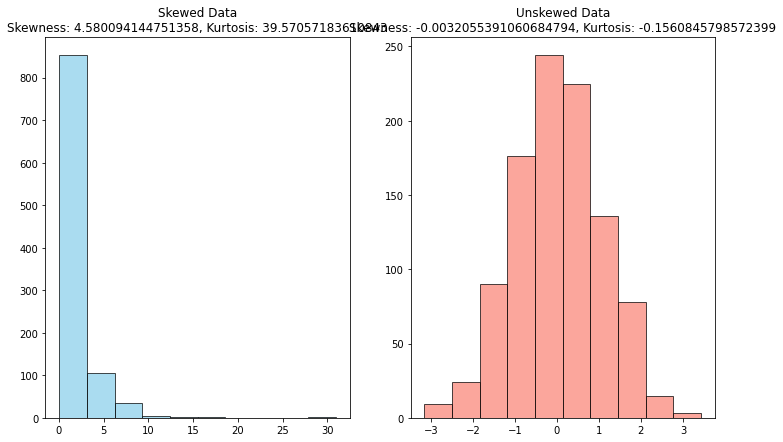

In [46]:
import numpy as np
from scipy.stats import skew, kurtosis
import matplotlib.pyplot as plt

# Generate skewed data
skewed_data = np.random.lognormal(0, 1, 1000)

# Calculate skewness and kurtosis
sd_skew = skew(skewed_data)
sd_kurtosis = kurtosis(skewed_data)

# Transform data to unskewed
unskewed_data = np.log(skewed_data)
unskewed_skew = skew(unskewed_data)
unskewed_kurtosis = kurtosis(unskewed_data)

plt.figure(figsize=(12, 7))

# First subplot - Skewed Data
plt.subplot(1, 2, 1)
plt.hist(skewed_data, color="skyblue", edgecolor='black', alpha=0.7)
plt.title(f"Skewed Data\nSkewness: {sd_skew}, Kurtosis: {sd_kurtosis}")

# Second subplot - Unskewed Data
plt.subplot(1, 2, 2)
plt.hist(unskewed_data, color="salmon", edgecolor='black', alpha=0.7)
plt.title(f"Unskewed Data\nSkewness: {unskewed_skew}, Kurtosis: {unskewed_kurtosis}")

plt.show()


# Students

In [47]:
path = "C:\\Users\\alok\\Downloads\\students.csv"
import pandas as pd 
data = pd.read_csv(path)

In [48]:
data.head()

,stud.id,name,gender,age,height,weight,religion,nc.score,semester,major,minor,score1,score2,online.tutorial,graduated,salary
1,833917,"Gonzales, Christina",Female,19,160,64.8,Muslim,1.91,1st,Political Science,Social Sciences,NaN,NaN,0,0,NaN
2,898539,"Lozano, T'Hani",Female,19,172,73.0,Other,1.56,2nd,Social Sciences,Mathematics and Statistics,NaN,NaN,0,0,NaN
3,379678,"Williams, Hanh",Female,22,168,70.6,Protestant,1.24,3rd,Social Sciences,Mathematics and Statistics,45.0,46.0,0,0,NaN
4,807564,"Nem, Denzel",Male,19,183,79.7,Other,1.37,2nd,Environmental Sciences,Mathematics and Statistics,NaN,NaN,0,0,NaN
5,383291,"Powell, Heather",Female,21,175,71.4,Catholic,1.46,1st,Environmental Sciences,Mathematics and Statistics,NaN,NaN,0,0,NaN


In [49]:
weight = data['weight']

In [50]:
weight

1       64.8
2       73.0
3       70.6
4       79.7
5       71.4
        ... 
8235    79.1
8236    72.6
8237    67.7
8238    98.6
8239    69.0
Name: weight, Length: 8239, dtype: float64

In [51]:
mean = np.mean(weight)
std = np.std(weight)

In [53]:
mean,std

(72.99813084112151, 8.634637630634796)

In [ ]:
skewed = skew(weight)
kurt = kurtosis(weight)

In [ ]:
from scipy.stats import zscore
z_score_data = zscore(weight)

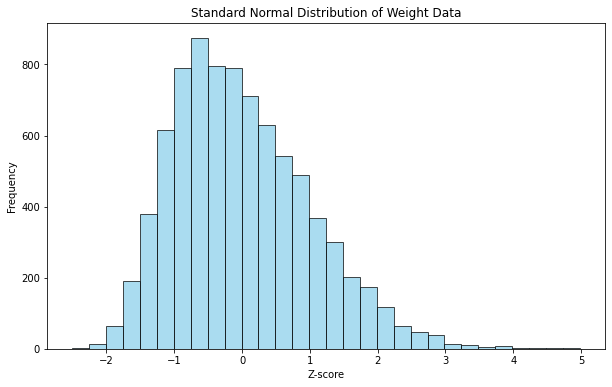

In [ ]:
plt.figure(figsize=(10, 6))

plt.hist(z_score_data, bins=30, color='skyblue', edgecolor='black', alpha=0.7)
plt.title('Standard Normal Distribution of Weight Data')
plt.xlabel('Z-score')
plt.ylabel('Frequency')



NameError: name 'weight_data' is not defined

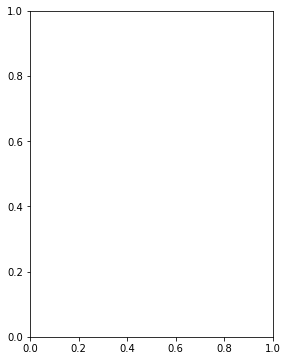

In [ ]:
import seaborn as sns
plt.figure(figsize=(10, 6))

plt.subplot(1,4,1)
sns.distplot(weight, color='skyblue', hist=True)
plt.title('Distribution of Weight Data')
plt.xlabel('Weight')
plt.ylabel('Density')

plt.subplot(1,4,2)
sns.distplot(mean, color='skyblue', hist=True)
plt.title('Distribution of Mean Weight Data')
plt.xlabel('Mean')
plt.ylabel('Density')

plt.subplot(1,4,3)
sns.distplot(std, color='skyblue', hist=True)
plt.title('Distribution of Standard DEV Weight Data')
plt.xlabel('Standard Dev')
plt.ylabel('Density')

plt.subplot(1,4,4)
sns.distplot(z_score_data, color='skyblue', hist=True)
plt.title('Distribution of Z Score Weight Data')
plt.xlabel('Z Score')
plt.ylabel('Density')
plt.show()

C:\Users\alok\AppData\Local\Temp\ipykernel_19592\3951925760.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


c:\Users\alok\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



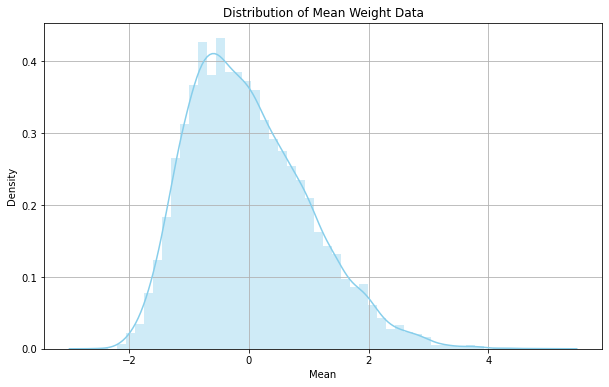

In [ ]:
plt.figure(figsize=(10, 6))
sns.distplot(z_score_data, color='skyblue', hist=True)
plt.title('Distribution of Z Score Weight Data')
plt.xlabel('Z Score')
plt.ylabel('Density')

plt.show()

In [58]:
# 1.
z_score = (60 - mean) / std
print("The weight of 60 is {} standard deviations away from the mean.".format(z_score))


# 2. Considering the weight data of student with mean 72.9 and standard deviation of 8.63, what is the probability of selecting a student having weight less than 65?

from scipy.stats import norm


# Calculate the z-score for the weight
z_score = (65 - mean) / std

# Calculate the probability using the cumulative distribution function (CDF)
probability_less_than_65 = norm.cdf(z_score)

print("The probability of selecting a student with weight less than 65 is:", probability_less_than_65)


The weight of 60 is -1.505347577645354 standard deviations away from the mean.
The probability of selecting a student with weight less than 65 is: 0.1771490792358733
